In [7]:
# the notebook, instead of on a separate window.
%matplotlib inline
# See all the "as ..." contructs? They're just aliasing the package names.
# That way we can call methods like plt.plot() instead of matplotlib.pyplot.plot().
import numpy as np
import scipy as sp
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import pandas as pd
import time
pd.set_option('display.width', 500)
pd.set_option('display.max_columns', 100)
pd.set_option('display.notebook_repr_html', True)
import seaborn as sns
sns.set_style("whitegrid")
sns.set_context("poster")
plt.rcParams["figure.figsize"] = (25,15)

In [2]:
from scipy.stats.distributions import bernoulli
def throw_a_coin(n):
    brv = bernoulli(0.5)
    return brv.rvs(size=n)

In [3]:
random_flips = throw_a_coin(10000)
running_means = np.zeros(10000)
sequence_lengths = np.arange(1, 10001, 1)
for i in sequence_lengths:
    running_means[i-1] = np.mean(random_flips[:i])

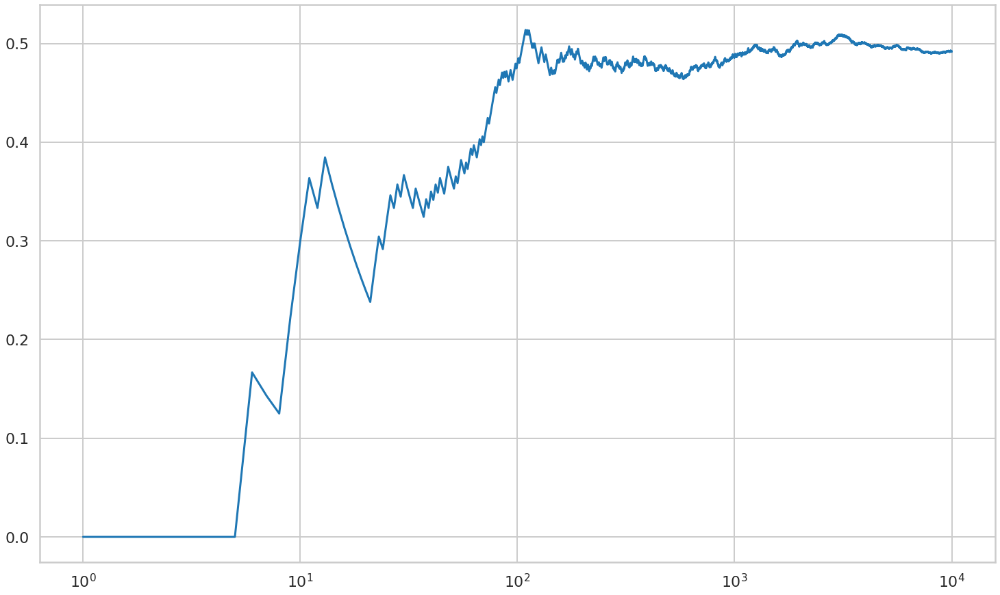

In [12]:
plt.plot(sequence_lengths, running_means);
plt.xscale('log')

# Samples from a population of coin flips

In [15]:
def make_throws(number_of_samples, sample_size):
    start=np.zeros((number_of_samples, sample_size), dtype=int)
    for i in range(number_of_samples):
        start[i, :] = throw_a_coin(sample_size)
    return np.mean(start, axis=1)

In [16]:
make_throws(number_of_samples=20, sample_size=10)

array([0.6, 0.5, 0.8, 0.5, 0.2, 0.6, 0.7, 0.5, 0.6, 0.3, 0.4, 0.4, 0.3,
       0.6, 0.5, 0.4, 0.6, 0.5, 0.2, 0.5])

In [17]:
sample_sizes=np.arange(1, 1001, 1)
sample_means = [make_throws(number_of_samples=200, sample_size=i) for i in sample_sizes]

In [18]:
mean_of_sample_means = [np.mean(means) for means in sample_means] 

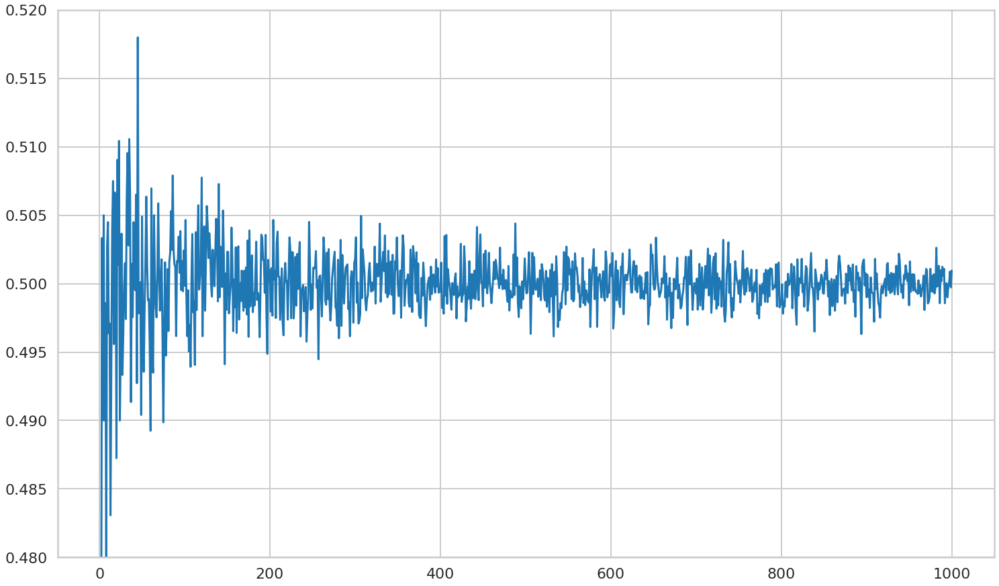

In [19]:
plt.plot(sample_sizes, mean_of_sample_means);
plt.ylim([0.48, 0.52]);

## The sampling distribution as a function of sample size

In [29]:
sample_means

[array([0., 0., 1., 0., 1., 0., 1., 0., 1., 0., 1., 1., 1., 0., 0., 0., 0.,
        1., 0., 1., 0., 0., 0., 0., 0., 0., 1., 1., 0., 1., 1., 0., 1., 0.,
        1., 1., 1., 0., 1., 0., 0., 1., 1., 1., 1., 0., 1., 0., 0., 0., 1.,
        0., 1., 1., 1., 1., 0., 0., 1., 0., 1., 1., 0., 0., 1., 0., 1., 1.,
        0., 0., 0., 1., 1., 0., 1., 1., 0., 1., 1., 1., 1., 0., 1., 1., 0.,
        1., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 0., 1., 1., 1., 1., 0.,
        1., 1., 0., 1., 0., 0., 0., 1., 0., 1., 0., 1., 1., 0., 0., 0., 1.,
        1., 0., 0., 0., 1., 0., 1., 1., 0., 0., 1., 0., 0., 0., 0., 0., 1.,
        0., 1., 1., 0., 0., 1., 1., 1., 0., 0., 1., 1., 0., 0., 1., 0., 0.,
        0., 0., 0., 1., 0., 0., 0., 0., 0., 1., 0., 1., 0., 1., 1., 1., 0.,
        1., 0., 1., 0., 1., 1., 0., 1., 0., 1., 1., 0., 1., 1., 0., 0., 1.,
        0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 1., 0., 1.]),
 array([0. , 0. , 0.5, 1. , 1. , 1. , 0.5, 0.5, 0.5, 0.5, 0. , 0.5, 0. ,
        0.5, 0.5, 1. , 1. , 1

In [20]:
sample_means_at_size_10 = sample_means[9]
sample_means_at_size_100 = sample_means[99]
sample_means_at_size_1000 = sample_means[999]

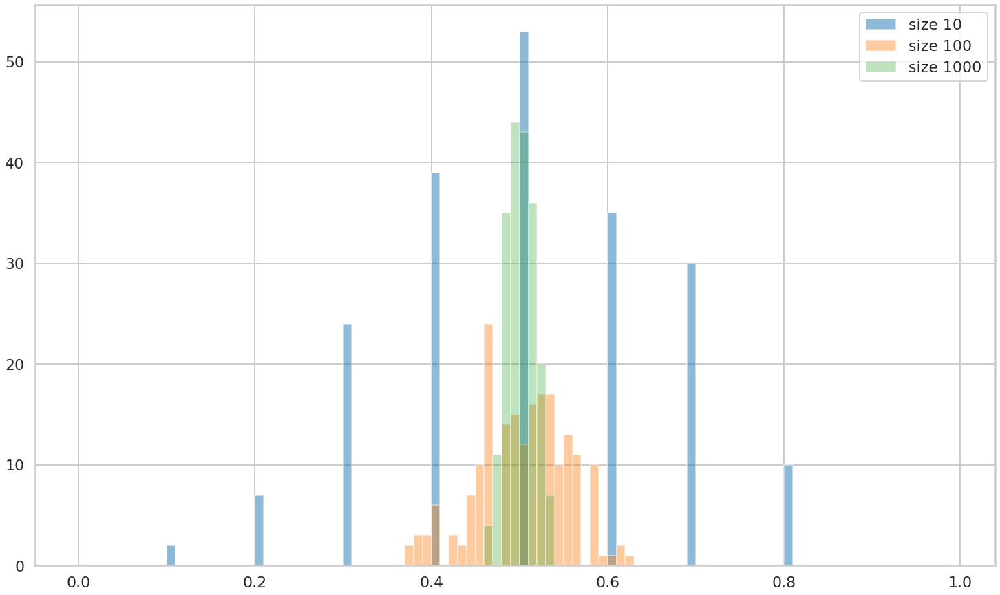

In [28]:
plt.hist(sample_means_at_size_10, bins=np.arange(0, 1, 0.01), alpha=0.5, label="size 10");
plt.hist(sample_means_at_size_100, bins=np.arange(0, 1, 0.01), alpha=0.4, label="size 100");
plt.hist(sample_means_at_size_1000, bins=np.arange(0, 1, 0.01), alpha=0.3, label="size 1000");
plt.legend();

In [30]:
sample_sizes

array([   1,    2,    3,    4,    5,    6,    7,    8,    9,   10,   11,
         12,   13,   14,   15,   16,   17,   18,   19,   20,   21,   22,
         23,   24,   25,   26,   27,   28,   29,   30,   31,   32,   33,
         34,   35,   36,   37,   38,   39,   40,   41,   42,   43,   44,
         45,   46,   47,   48,   49,   50,   51,   52,   53,   54,   55,
         56,   57,   58,   59,   60,   61,   62,   63,   64,   65,   66,
         67,   68,   69,   70,   71,   72,   73,   74,   75,   76,   77,
         78,   79,   80,   81,   82,   83,   84,   85,   86,   87,   88,
         89,   90,   91,   92,   93,   94,   95,   96,   97,   98,   99,
        100,  101,  102,  103,  104,  105,  106,  107,  108,  109,  110,
        111,  112,  113,  114,  115,  116,  117,  118,  119,  120,  121,
        122,  123,  124,  125,  126,  127,  128,  129,  130,  131,  132,
        133,  134,  135,  136,  137,  138,  139,  140,  141,  142,  143,
        144,  145,  146,  147,  148,  149,  150,  1

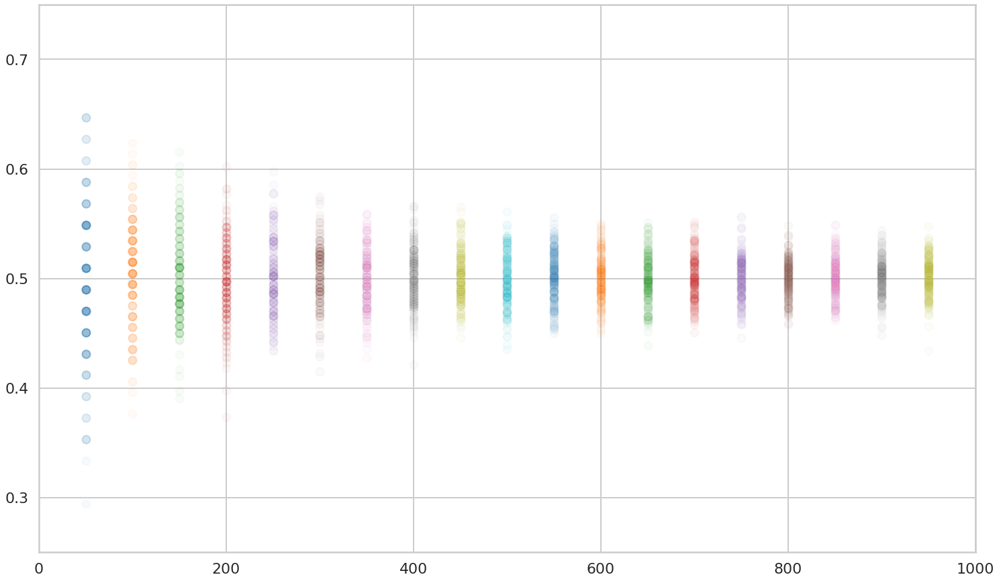

In [31]:
for i in sample_sizes:
    if i%50 == 0 and i < 1000:
        plt.scatter([i]*200, sample_means[i], alpha=0.03);
plt.xlim([0, 1000])
plt.ylim([0.25, 0.75]);

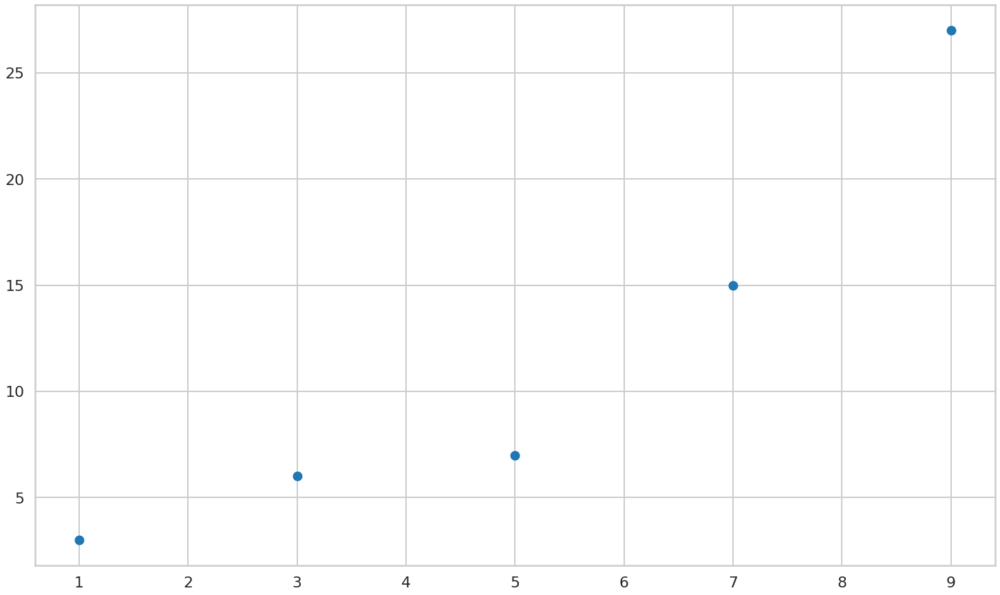

In [32]:
x = [1, 3, 5, 7, 9]
y = [3, 6, 7, 15, 27]
plt.scatter(x, y);

# The variation of the sample mean

sample size 越大，deviation of sample means 越小

In [34]:
sample_means

[array([0., 0., 1., 0., 1., 0., 1., 0., 1., 0., 1., 1., 1., 0., 0., 0., 0.,
        1., 0., 1., 0., 0., 0., 0., 0., 0., 1., 1., 0., 1., 1., 0., 1., 0.,
        1., 1., 1., 0., 1., 0., 0., 1., 1., 1., 1., 0., 1., 0., 0., 0., 1.,
        0., 1., 1., 1., 1., 0., 0., 1., 0., 1., 1., 0., 0., 1., 0., 1., 1.,
        0., 0., 0., 1., 1., 0., 1., 1., 0., 1., 1., 1., 1., 0., 1., 1., 0.,
        1., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 0., 1., 1., 1., 1., 0.,
        1., 1., 0., 1., 0., 0., 0., 1., 0., 1., 0., 1., 1., 0., 0., 0., 1.,
        1., 0., 0., 0., 1., 0., 1., 1., 0., 0., 1., 0., 0., 0., 0., 0., 1.,
        0., 1., 1., 0., 0., 1., 1., 1., 0., 0., 1., 1., 0., 0., 1., 0., 0.,
        0., 0., 0., 1., 0., 0., 0., 0., 0., 1., 0., 1., 0., 1., 1., 1., 0.,
        1., 0., 1., 0., 1., 1., 0., 1., 0., 1., 1., 0., 1., 1., 0., 0., 1.,
        0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 1., 0., 1.]),
 array([0. , 0. , 0.5, 1. , 1. , 1. , 0.5, 0.5, 0.5, 0.5, 0. , 0.5, 0. ,
        0.5, 0.5, 1. , 1. , 1

In [35]:
std_of_sample_means_1000 = [np.std(means) for means in sample_means]

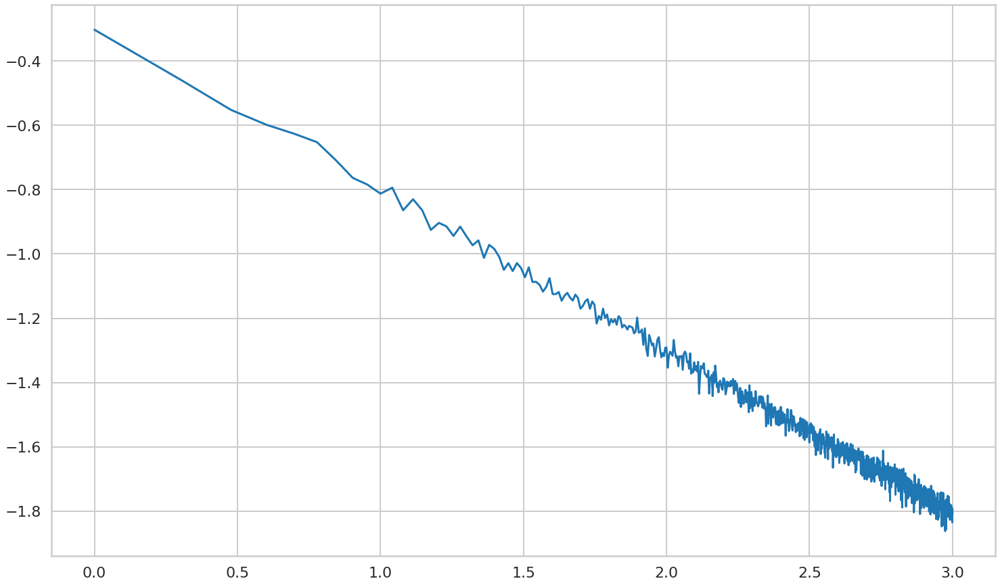

In [36]:
plt.plot(np.log10(sample_sizes), np.log10(std_of_sample_means_1000))

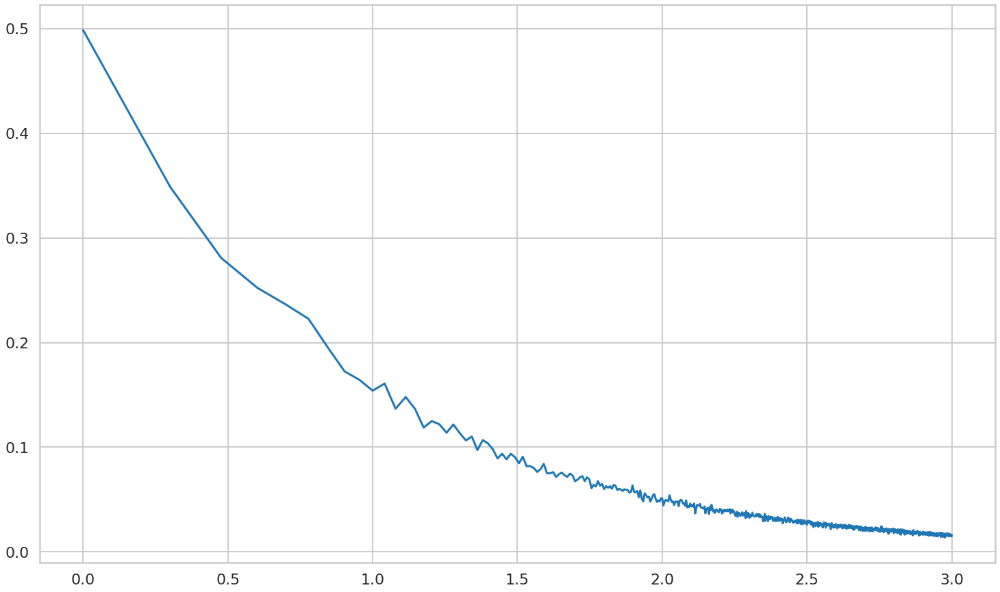

In [38]:
plt.plot(np.log10(sample_sizes), std_of_sample_means_1000);

In [39]:
sample_means_at_size_1000

array([0.498, 0.477, 0.497, 0.495, 0.484, 0.5  , 0.513, 0.51 , 0.51 ,
       0.5  , 0.524, 0.499, 0.483, 0.507, 0.511, 0.51 , 0.497, 0.499,
       0.52 , 0.487, 0.511, 0.508, 0.509, 0.48 , 0.506, 0.517, 0.473,
       0.508, 0.475, 0.493, 0.505, 0.508, 0.499, 0.484, 0.506, 0.522,
       0.495, 0.494, 0.502, 0.491, 0.477, 0.49 , 0.507, 0.491, 0.488,
       0.481, 0.514, 0.485, 0.512, 0.509, 0.506, 0.483, 0.512, 0.496,
       0.492, 0.484, 0.489, 0.494, 0.506, 0.508, 0.511, 0.521, 0.532,
       0.491, 0.492, 0.499, 0.518, 0.491, 0.495, 0.496, 0.491, 0.505,
       0.503, 0.519, 0.48 , 0.497, 0.473, 0.493, 0.481, 0.517, 0.512,
       0.512, 0.475, 0.521, 0.498, 0.484, 0.506, 0.511, 0.514, 0.501,
       0.496, 0.499, 0.524, 0.502, 0.511, 0.51 , 0.501, 0.527, 0.481,
       0.47 , 0.506, 0.513, 0.506, 0.489, 0.494, 0.532, 0.5  , 0.492,
       0.528, 0.497, 0.473, 0.499, 0.491, 0.508, 0.512, 0.525, 0.522,
       0.503, 0.499, 0.497, 0.511, 0.502, 0.488, 0.527, 0.514, 0.489,
       0.506, 0.485,

sample size 足够大时， distribution of sample means 符合正态分布

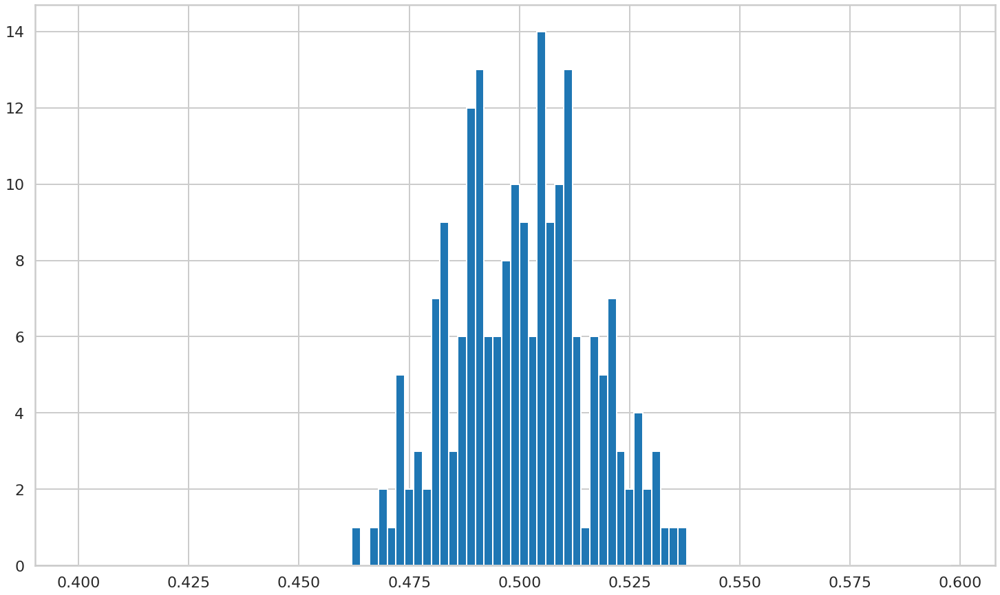

In [41]:
plt.hist(sample_means_at_size_1000, bins=np.arange(0.4, 0.6, 0.002));

# Gaussian Distribution

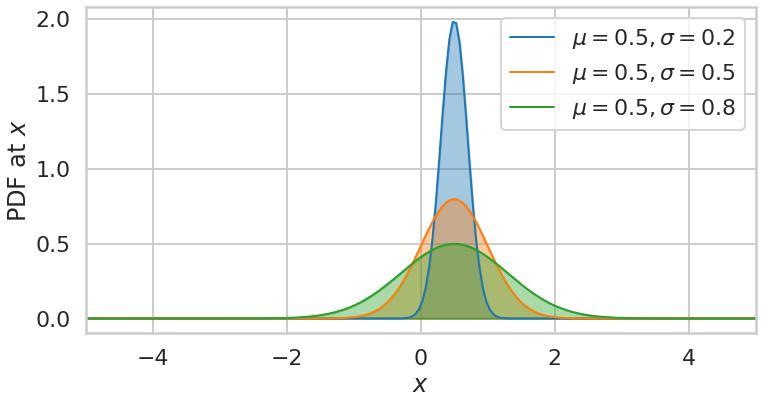

In [44]:
colors=sns.color_palette()

norm = sp.stats.norm
x = np.linspace(-5, 5, num=200)

fig = plt.figure(figsize=(12, 6))
for mu, sigma, c in zip([0.5]*3, [0.2, 0.5, 0.8], colors):
    plt.plot(x, norm.pdf(x, mu, sigma), lw=2,
             c=c, label = r"$\mu = {0:.1f}, \sigma={1:.1f}$".format(mu, sigma))
    plt.fill_between(x, norm.pdf(x, mu, sigma), color=c, alpha = .4)
    
plt.xlim([-5, 5])
plt.legend(loc=0)
plt.ylabel("PDF at $x$")
plt.xlabel("$x$");


# The sampling distribution of the Variance

In [ ]:
sample_sizes

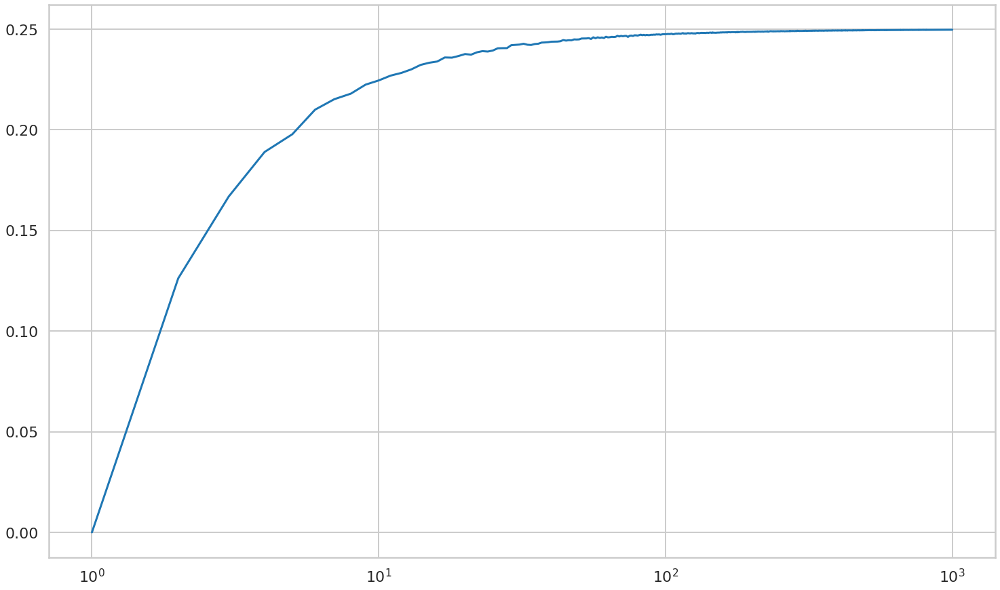

In [45]:
def make_throws_var(number_of_samples, sample_size):
    start = np.zeros((number_of_samples, sample_size), dtype=int)
    for i in range(number_of_samples):
        start[i, :] = throw_a_coin(sample_size)
    return np.var(start, axis=1)

sample_sizes=np.arange(1, 1001, 1)
sample_vars_1000_replicates = [make_throws_var(number_of_samples=1000, sample_size=i) for i in sample_sizes]
mean_of_sample_vars_1000 = [np.mean(vars) for vars in sample_vars_1000_replicates]
plt.plot(sample_sizes, mean_of_sample_vars_1000);
plt.xscale("log")

In [46]:
sample_vars_1000_replicates

[array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 

In [50]:
len(sample_vars_1000_replicates[0])

1000

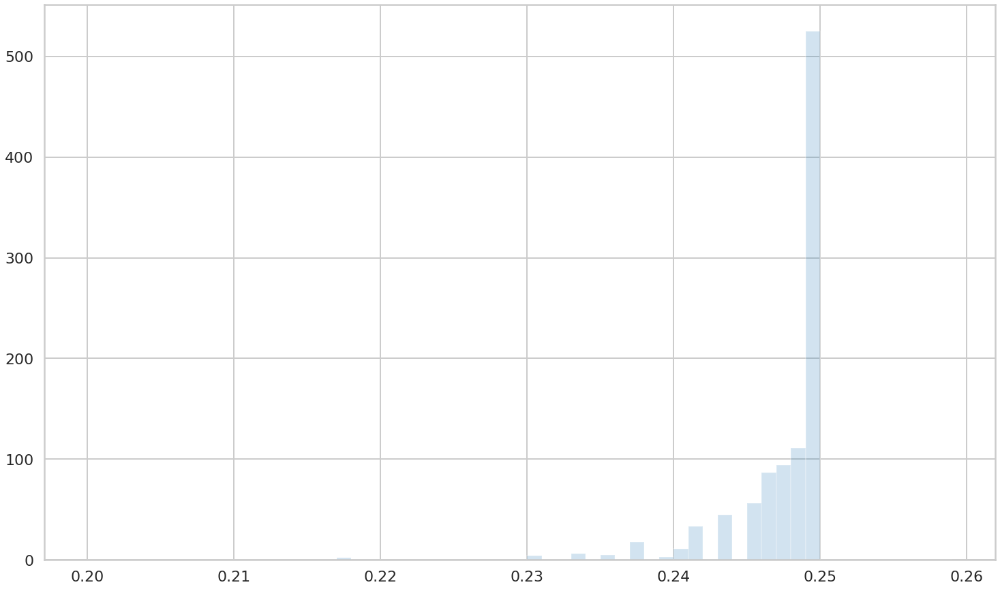

In [52]:
plt.hist(sample_vars_1000_replicates[99], bins=np.arange(0.2, 0.26, 0.001), alpha=0.2, density=True);

# An application: Gallup Party Affiliation Poll

In [53]:
gallup_2012=pd.read_csv("g12.csv").set_index('State')

In [56]:
gallup_2012["Unknown"] = 100 - gallup_2012.Democrat - gallup_2012.Republican
gallup_2012.head()

,Democrat,Republican,Dem_Adv,N,Unknown
State,,,,,
Alabama,36.0,49.6,-13.6,3197,14.4
Alaska,35.9,44.3,-8.4,402,19.8
Arizona,39.8,47.3,-7.5,4325,12.9
Arkansas,41.5,40.8,0.7,2071,17.7
California,48.3,34.6,13.7,16197,17.1


In [57]:
gallup_2012["SE_percentage"]=100.0*np.sqrt((gallup_2012.Democrat/100.) * ((100. - gallup_2012.Democrat)/100.) / (gallup_2012.N - 1))
gallup_2012.head()

,Democrat,Republican,Dem_Adv,N,Unknown,SE_percentage
State,,,,,,
Alabama,36.0,49.6,-13.6,3197,14.4,0.849059
Alaska,35.9,44.3,-8.4,402,19.8,2.395543
Arizona,39.8,47.3,-7.5,4325,12.9,0.744384
Arkansas,41.5,40.8,0.7,2071,17.7,1.082971
California,48.3,34.6,13.7,16197,17.1,0.392658


In [58]:
from scipy.special import erf
def uncertain_gallup_model(gallup):
    sigma = 3
    prob = .5 * (1 + erf(gallup.Dem_Adv / np.sqrt(2 * sigma**2)))
    return pd.DataFrame(dict(Obama=prob), index=gallup.index)

In [60]:
model = uncertain_gallup_model(gallup_2012)

predictwise = pd.read_csv('predictwise.csv').set_index('States')
model = model.join(predictwise.Votes)

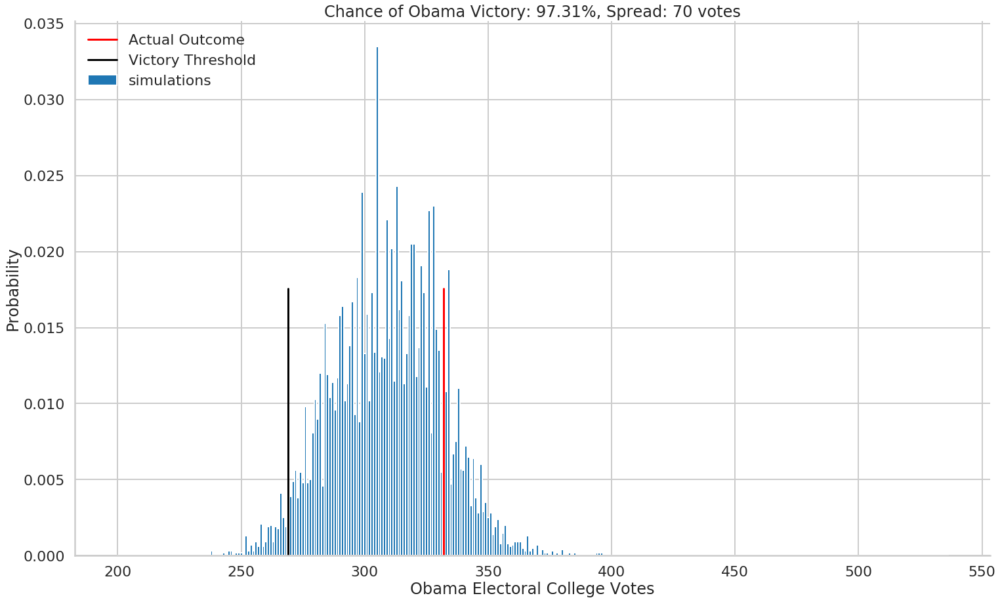

In [62]:
def simulate_election(model, n_sim):
    simulations = np.random.uniform(size=(51, n_sim))
    obama_votes = (simulations < model.Obama.values.reshape(-1, 1)) * model.Votes.values.reshape(-1, 1)
    return obama_votes.sum(axis=0)

def plot_simulation(simulation):
    plt.hist(simulation, bins=np.arange(200, 538, 1),
             label='simulations', align='left', density=True)
    plt.axvline(332, 0, .5, color='r', label='Actual Outcome')
    plt.axvline(269, 0, .5, color='k', label='Victory Threshold')
    p05 = np.percentile(simulation, 5.)
    p95 = np.percentile(simulation, 95.)
    iq = int(p95 - p05)
    pwin = ((simulation >= 269).mean()*100)
    plt.title("Chance of Obama Victory: %0.2f%%, Spread: %d votes" % (pwin, iq))
    plt.legend(frameon=False, loc='upper left')
    plt.xlabel("Obama Electoral College Votes")
    plt.ylabel("Probability")
    sns.despine()
    
prediction = simulate_election(model, 10000)
plot_simulation(prediction)